In [85]:
import sys
sys.path.append('.')

from bertopic.representation import KeyBERTInspired, VisualRepresentation
from bertopic.backend import MultiModalBackend
from bertopic import BERTopic
from PIL import Image
import os
import base64
from io import BytesIO
from IPython.display import HTML
from pathlib import Path
from torchvision import transforms
# sys.path.append(str(Path(os.path.abspath(__file__)).parent.parent.parent))

# from src.utils import preprocessing

# import thumbnails

# from experiments.config import global_config



In [3]:
# Image embedding model
embedding_model = MultiModalBackend('clip-ViT-B-32', batch_size=32)

# Image to text representation model
representation_model = {
    "Visual_Aspect": VisualRepresentation(image_to_text_model="nlpconnect/vit-gpt2-image-captioning")
}

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


In [124]:
# images
root_data = str(Path().resolve() / ".." / ".." / "data" / "training")

# images_path = os.path.join(root_data, 'V9/annotated/asphalt/bad')
# images_path = os.path.join(root_data, 'seg_analysis/original/not_recognizable/multi/streets')
images_path = os.path.join(root_data, 'V9/annotated')
images = []
for root, _, fnames in sorted(os.walk(images_path, followlinks=True)):
    for fname in sorted(fnames):
        path = os.path.join(root, fname)
        if fname.endswith((".jpg", ".jpeg", ".png")):
            images.append(path)

print(images[:5])

['/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/asphalt/bad/1108901116248517.jpg', '/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/asphalt/bad/1156688858072710.jpg', '/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/asphalt/bad/1165154770939283.jpg', '/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/asphalt/bad/1178313585927604.jpg', '/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/asphalt/bad/1198561677264617.jpg']


In [125]:
partial_labels = {'115613061245645': 'bikelane on sidewalk',
                  '147530060597553': 'biklane on street',
                  '152436594516951': 'bikelane on sidewalk',
                  '161779362788691': 'bikelane on sidewalk',
                  '314600876906279': 'biklane on street',
                  '324264732453909': 'bikelane on sidewalk',
                  '332779451733060': 'bikelane on sidewalk',
                  '371383354168821': 'biklane on street',
                  '406638231063174': 'bikelane on sidewalk',
                  '476023756839183': 'bikelane on sidewalk',
                  '485652966084685': 'bikelane on sidewalk',
                  '527494424951466': 'biklane on street',
                  '586506369409581': 'biklane on street',
                  '645723314281364': 'biklane on street',
                  }
labels_categories = ['bikelane on sidewalk', 'biklane on street']
def labels_index(label):
    class_to_idx = {labels_categories[i]: i for i in range(len(labels_categories))}
    return -1 if label not in class_to_idx.keys() else class_to_idx[label]

In [126]:
# for guided topic modeling only
seed_topic_list = [["bikelane on road"],
                   ["bikelane on sidewalk"],
                   ["driving"]]
# for zero-shot modeling only
zeroshot_topic_list = ["bikelane on road", "bikelane on sidewalk"]
# for semi-supervised modeling only
ids = [os.path.splitext(os.path.split(path)[-1])[0] for path in images]
labels = [partial_labels.get(id, 'no label') for id in ids]
y = [labels_index(label) for label in labels]


In [123]:
# transform images
images = [Image.open(img) for img in images]
images = [transforms.functional.crop(img, 0.5*img.size[1], 0, 0.5*img.size[1], img.size[0]) for img in images]

images[0]

OSError: [Errno 24] Too many open files: '/Users/edith/git/SurfaceAI/classification_models/src/utils/../../data/training/V9/annotated/sett/intermediate/169790915020244.jpg'

In [127]:
# standard
topic_model = BERTopic(embedding_model=embedding_model,
                       representation_model=representation_model,
                       min_topic_size=5)
topics, probs = topic_model.fit_transform(documents=None, images=images)
# # guided topic modeling
# topic_model = BERTopic(embedding_model=embedding_model,
#                        representation_model=representation_model,
#                        min_topic_size=5,
#                        seed_topic_list=seed_topic_list)
# topics, probs = topic_model.fit_transform(documents=None, images=images)
# # zero-shot topic modeling
# topic_model = BERTopic(embedding_model=embedding_model,
#                        representation_model=representation_model,
#                     #    min_topic_size=5,
#                        zeroshot_topic_list=zeroshot_topic_list,
#                        zeroshot_min_similarity=0.7,)
# topics, probs = topic_model.fit_transform(documents=None, images=images)
# # semi-supervised topic modeling
# topic_model = BERTopic(embedding_model=embedding_model,
#                        representation_model=representation_model,
#                        min_topic_size=5)
# topics, probs = topic_model.fit_transform(documents=None,
#                                           images=images,
#                                           y=y)

print(topics)
print(probs)

100%|██████████| 262/262 [01:56<00:00,  2.25it/s]


[-1, -1, -1, -1, -1, -1, -1, -1, 68, 19, -1, -1, -1, -1, -1, 23, -1, 203, 107, -1, -1, 181, -1, 89, -1, -1, -1, -1, -1, 8, -1, -1, -1, -1, 153, 5, 80, -1, 39, 196, -1, 255, 46, -1, -1, 203, -1, -1, -1, -1, -1, -1, -1, -1, 105, -1, 39, -1, 106, 68, -1, -1, -1, -1, 203, 4, -1, 233, -1, 84, 152, 35, -1, 0, 26, -1, -1, -1, 0, 26, 6, -1, -1, -1, -1, -1, 84, -1, -1, -1, -1, 72, -1, -1, -1, 21, 12, 100, -1, -1, 201, -1, 19, -1, 15, 63, -1, -1, -1, 21, -1, -1, 84, -1, 85, 15, 0, -1, 178, -1, -1, -1, 30, 33, -1, 7, -1, -1, -1, -1, 0, 164, 0, 26, -1, 148, 72, -1, 154, -1, 2, 0, 0, -1, -1, -1, 0, 7, 0, -1, 105, -1, -1, -1, 0, 207, 50, 2, -1, 41, -1, 7, 38, 0, -1, 0, -1, 46, -1, 121, 62, 63, 0, 12, -1, -1, 0, 0, 144, 7, -1, 180, 0, -1, 12, -1, 157, 9, 2, 0, 0, 0, 0, -1, 0, 41, 0, 158, -1, 158, -1, 217, -1, -1, -1, 164, -1, -1, -1, -1, 0, -1, 185, -1, 102, 49, 0, -1, 0, 19, -1, 0, 246, -1, 0, 123, 134, -1, 0, -1, 28, 243, 158, 36, -1, -1, 0, 18, -1, -1, -1, 53, 12, 79, 6, 12, 0, 0, 0, -1, 176, 42, 

In [115]:
print([id for i, id in enumerate(ids) if labels[i] != 'no label'])
print([labels[i] for i, _ in enumerate(ids) if labels[i] != 'no label'])
print([topic for i, topic in enumerate(topics) if labels[i] != 'no label'])

[]
[]
[]


In [116]:
def image_base64(im):
    if isinstance(im, str):
        # im = get_thumbnail(im)
        print("is string")
    with BytesIO() as buffer:
        im.save(buffer, 'jpeg')
        return base64.b64encode(buffer.getvalue()).decode()


def image_formatter(im):
    return f'<img src="data:image/jpeg;base64,{image_base64(im)}">'

In [117]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Visual_Aspect,Representative_Docs
0,-1,8,-1_walking_and_sidewalk_fence,"[walking, and, sidewalk, fence, with, stone, d...",<PIL.Image.Image image mode=RGB size=1374x600 ...,[a street with a brick wall and a few cars par...
1,0,1185,0_brick_with_sidewalk_and,"[brick, with, sidewalk, and, wall, the, on, fe...",<PIL.Image.Image image mode=RGB size=1600x600 ...,[a sidewalk with a brick wall and a train on i...
2,1,15,1_sitting_umbrella_blue_on,"[sitting, umbrella, blue, on, sidewalk, next, ...",<PIL.Image.Image image mode=RGB size=1600x600 ...,"[a blue umbrella sitting on a sidewalk , a blu..."


,Topic,Count,Representation,Visual_Aspect
0,-1,4895,"[near, few, stone, tree, sidewalk, light, lot, trees, road, car]",
1,0,453,"[highway, by, behind, lot, going, bunch, driving, it, train, cars]",
2,1,102,"[people, bicycle, crosswalk, bunch, walking, van, scene, buildings, man, sidewalk]",
3,2,82,"[highway, traffic, lot, view, truck, it, city, driving, sign, light]",
4,3,79,"[bridge, railings, yard, balcony, long, lots, from, benches, over, motorcycle]",
5,4,64,"[van, cars, few, parked, city, it, scene, side, on, the]",
6,5,62,"[wooded, area, trail, trees, in, dirt, leads, filled, of, forest]",
7,6,54,"[past, house, driving, buildings, is, car, down, near, front, building]",
8,7,50,"[no, sky, background, stopped, says, at, bridge, dog, red, traffic]",
9,8,50,"[trail, woods, village, forest, dirt, trees, leads, middle, in, filled]",

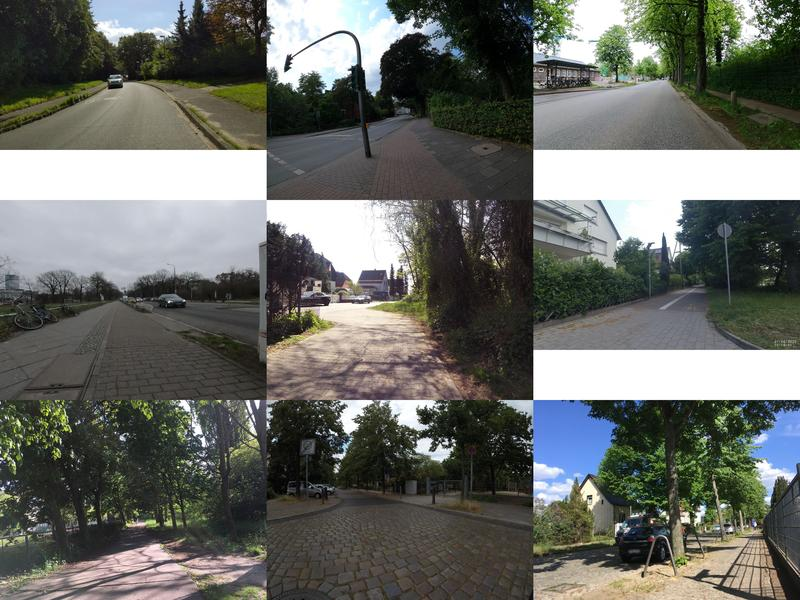
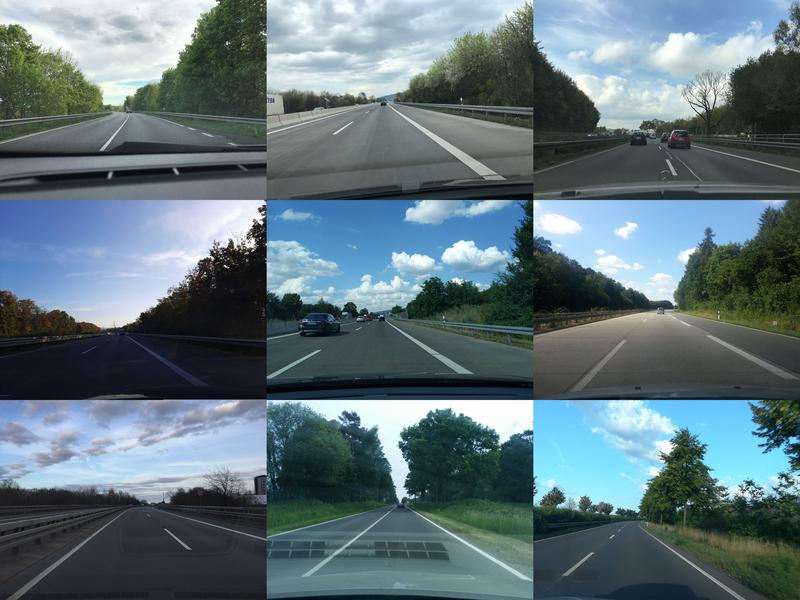
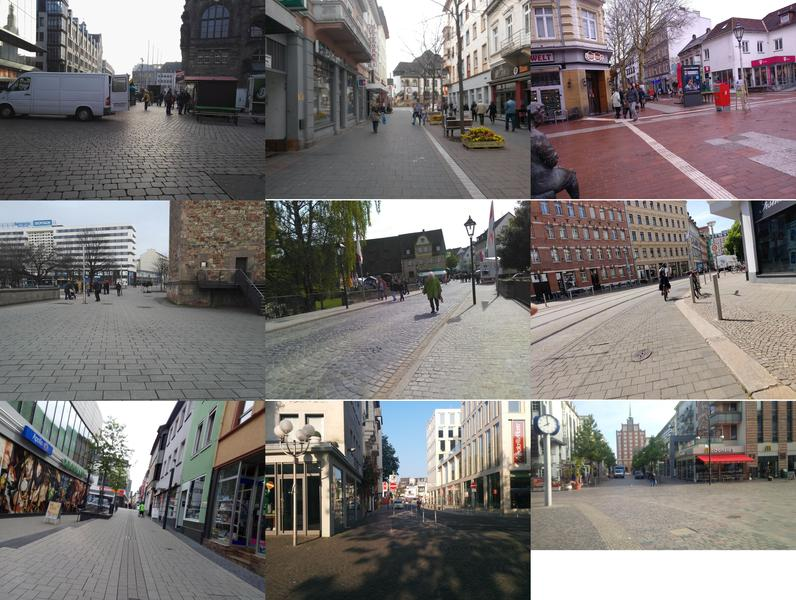
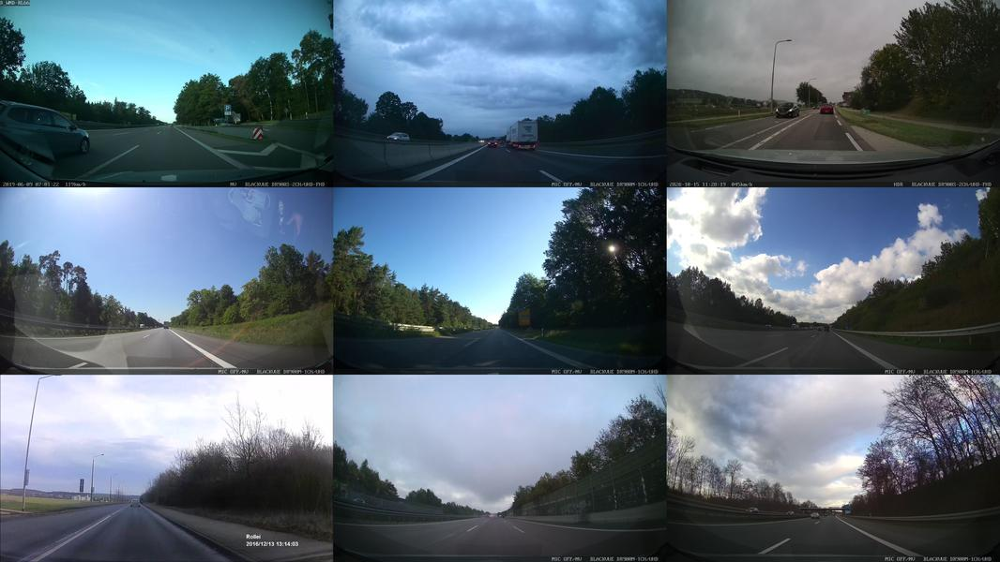
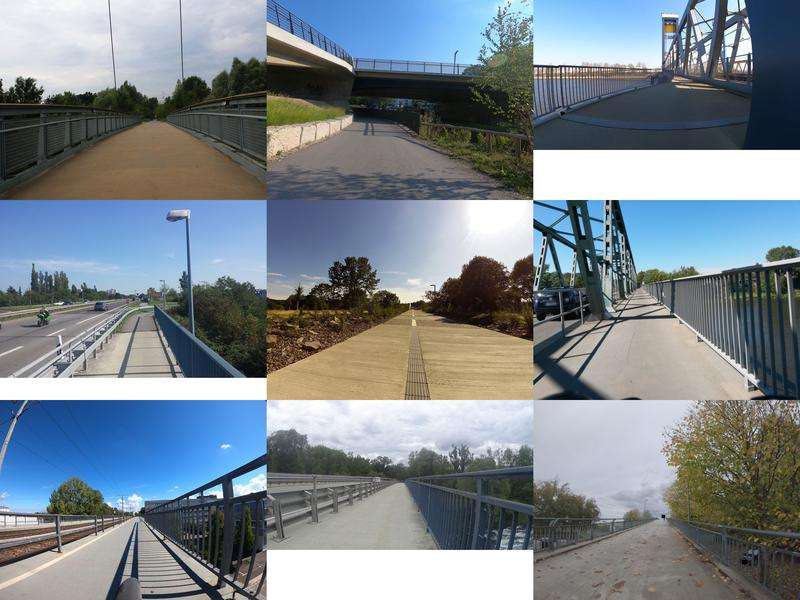
...
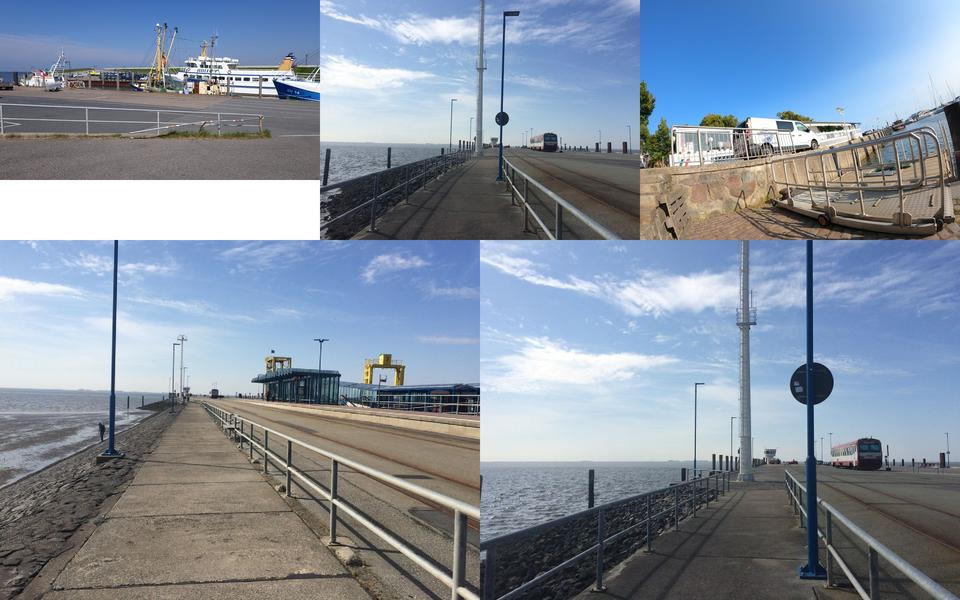
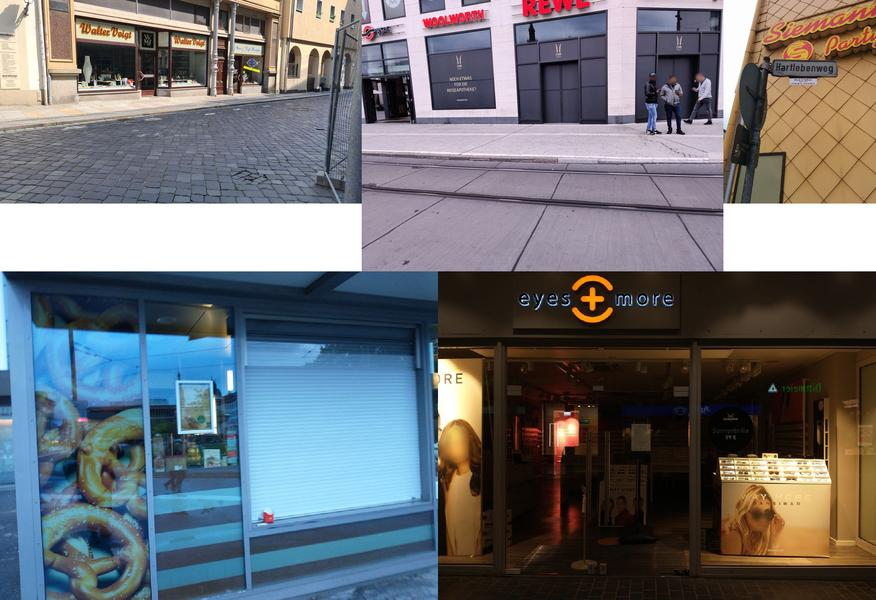
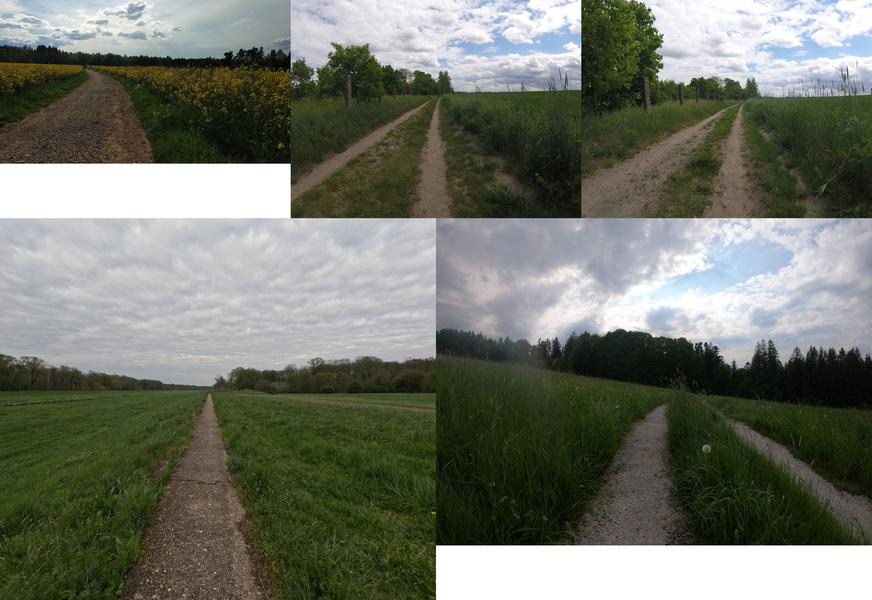
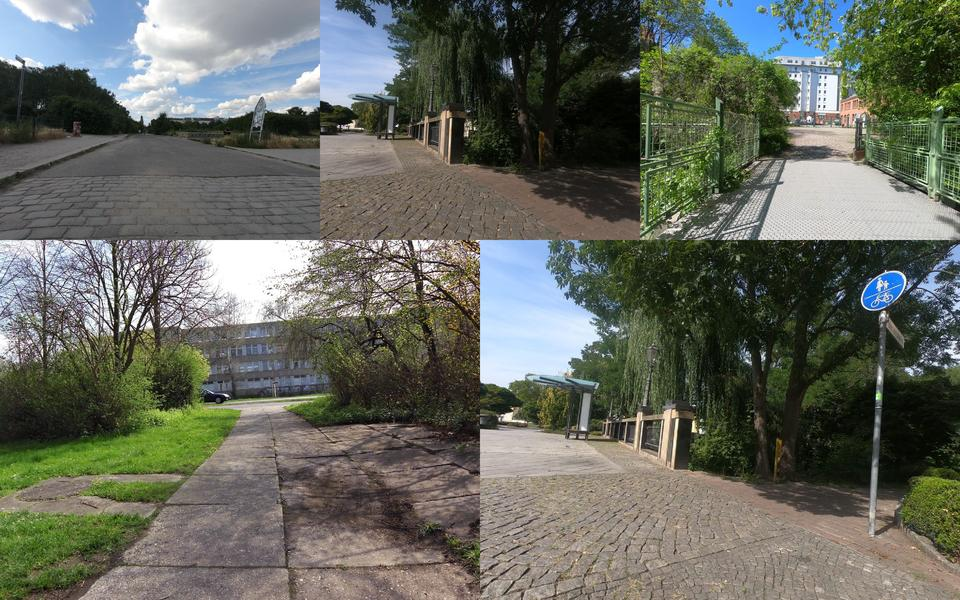
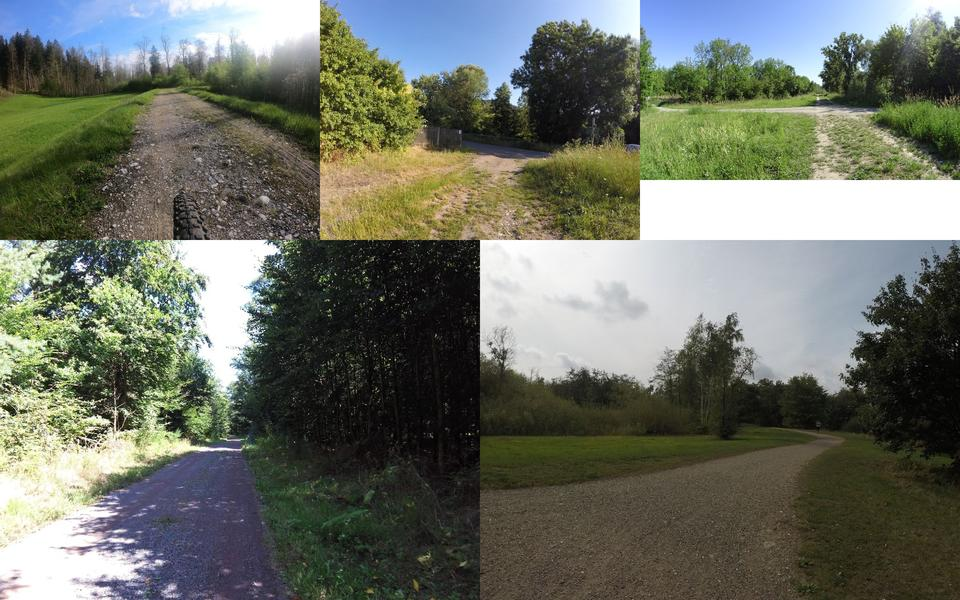

In [128]:
df = topic_model.get_topic_info().drop("Representative_Docs", axis=1).drop("Name", axis=1)

# Visualize the images
HTML(df.to_html(formatters={'Visual_Aspect': image_formatter}, escape=False))

In [119]:
topic_model.visualize_topics()

ValueError: zero-size array to reduction operation maximum which has no identity

In [20]:
df["Visual_Aspect"][0].show()

In [27]:
topic_model.get_topic(-1)

[('fence', 0.23891678081817982),
 ('post', 0.10566114475338913),
 ('small', 0.10566114475338913),
 ('with', 0.0963663821919514),
 ('down', 0.09367761346841302),
 ('next', 0.09367761346841302),
 ('house', 0.0853104222227625),
 ('to', 0.0853104222227625),
 ('and', 0.08307241335070867),
 ('the', 0.06767709548277356)]

In [30]:
topic_model.get_params()

{'calculate_probabilities': False,
 'ctfidf_model': ClassTfidfTransformer(),
 'embedding_model': <bertopic.backend._multimodal.MultiModalBackend at 0x1392e78e0>,
 'hdbscan_model': HDBSCAN(prediction_data=True),
 'language': None,
 'low_memory': False,
 'min_topic_size': 5,
 'n_gram_range': (1, 1),
 'nr_topics': None,
 'representation_model': {'Visual_Aspect': VisualRepresentation(image_to_text_model=<transformers.pipelines.image_to_text.ImageToTextPipeline object at 0x139c9a260>)},
 'seed_topic_list': None,
 'top_n_words': 10,
 'umap_model': UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.0, n_components=5, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True}),
 'vectorizer_model': CountVectorizer(),
 'verbose': False,
 'zeroshot_min_similarity': 0.7,
 'zeroshot_topic_list': None}

In [36]:
topic_model.topic_embeddings_.shape

(5, 512)

In [69]:
topic_model.visualize_heatmap()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'coloraxis': 'coloraxis',
              'hovertemplate': 'x: %{x}<br>y: %{y}<br>Similarity Score: %{z}<extra></extra>',
              'name': '0',
              'type': 'heatmap',
              'x': [0_the_street_side, 1_near_on_it, 2_driving_down_road,
                    3_brick_parked_on, 4_is_church_car, 5_building_next_to],
              'xaxis': 'x',
              'y': [0_the_street_side, 1_near_on_it, 2_driving_down_road,
                    3_brick_parked_on, 4_is_church_car, 5_building_next_to],
              'yaxis': 'y',
              'z': array([[1.        , 0.92776164, 0.86208807, 0.9164526 , 0.90919991,
                           0.89761747],
                          [0.92776164, 1.        , 0.92394276, 0.90376722, 0.9023344 ,
                           0.86461795],
                          [0.86208807, 0.92394276, 1.        , 0.87833419, 0.91193665,
                           0.83742681],
                          [0.9164526 , 0.90376722, 0.87833419, 1.        , 0.89990494,
                           0.87086905],
                          [0.90919991, 0.9023344 , 0.91193665, 0.89990494, 1.        ,
                           0.89177069],
                          [0.89761747, 0.86461795, 0.83742681, 0.87086905, 0.89177069,
                           1.        ]])}],
    'layout': {'coloraxis': {'colorbar': {'title': {'text': 'Similarity Score'}},
                             'colorscale': [[0.0, 'rgb(247,252,240)'], [0.125,
                                            'rgb(224,243,219)'], [0.25,
                                            'rgb(204,235,197)'], [0.375,
                                            'rgb(168,221,181)'], [0.5,
                                            'rgb(123,204,196)'], [0.625,
                                            'rgb(78,179,211)'], [0.75,
                                            'rgb(43,140,190)'], [0.875,
                                            'rgb(8,104,172)'], [1.0,
                                            'rgb(8,64,129)']]},
               'height': 800,
               'hoverlabel': {'bgcolor': 'white', 'font': {'family': 'Rockwell', 'size': 16}},
               'legend': {'title': {'text': 'Trend'}},
               'margin': {'t': 60},
               'showlegend': True,
               'template': '...',
               'title': {'font': {'color': 'Black', 'size': 22},
                         'text': '<b>Similarity Matrix</b>',
                         'x': 0.55,
                         'xanchor': 'center',
                         'y': 0.95,
                         'yanchor': 'top'},
               'width': 800,
               'xaxis': {'anchor': 'y', 'constrain': 'domain', 'domain': [0.0, 1.0], 'scaleanchor': 'y'},
               'yaxis': {'anchor': 'x', 'autorange': 'reversed', 'constrain': 'domain', 'domain': [0.0, 1.0]}}
})